In [2]:
#import import_ipynb
#import Scanpy_functions_v03262021 as sc_pipe
import scvelo as scv
scv.logging.print_version()
import warnings
#import scirpy as ir
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb


Running scvelo 0.2.4 (python 3.8.13) on 2023-02-20 13:00.


In [3]:

In_path = '/user/ifrec/liuyuchen/scRNASeq_DATA/Akira_Fukusima_scRNASeq/'

out_path = '/user/ifrec/liuyuchen/Analysis_Reports/Akira_Fukusima_scRNASeq/human/'

In [4]:
#sc.set_figure_params(scanpy=True, dpi=200,  figsize=[12.8,9.6])
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization


In [5]:
import cellrank as cr
scv.settings.verbosity = 3
scv.settings.set_figure_params("scvelo")
cr.settings.verbosity = 2

In [6]:
adata=sc.read_h5ad(out_path+'/human_subset_0707_cluster3_6.h5ad')

ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI no longer supports 'pip search' (or XML-RPC search). Please use https://pypi.org/search (via a browser) instead. See https://warehouse.pypa.io/api-reference/xml-rpc.html#deprecated-methods for more information.


In [13]:
adata.obs['Defined_type']=adata.obs['Defined_type'].astype(str)

In [14]:
adata.obs.loc[adata.obs['Defined_type']=='FMC macrophage','Defined_type']='FMF-like macrophage'
adata.obs.loc[adata.obs['Defined_type']=='FMC macrophage-1','Defined_type']='FMF-like macrophage-1'
adata.obs.loc[adata.obs['Defined_type']=='FMC macrophage-2','Defined_type']='FMF-like macrophage-2'

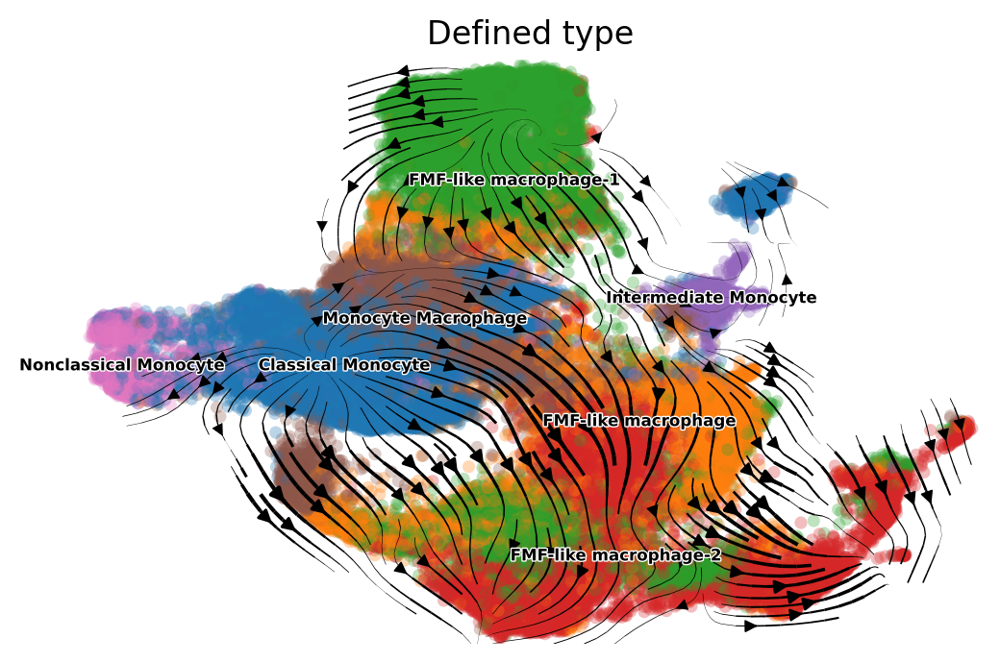

In [15]:

scv.pl.velocity_embedding_stream(
   adata, basis="umap", legend_fontsize=6, color ='Defined_type',smooth=0.8, min_mass=2, 
)


In [6]:
adata.obs['Defined_type'].to_csv(out_path+'meta.txt')

In [11]:
pd.DataFrame(adata.X.A,columns=adata.var_names,index=adata.obs.index).T.to_csv(out_path+'/cluster3_6_no_layer.txt')

In [5]:
ref=sc.read_h5ad(out_path+'/human_subset_remove_PBMC_DC.h5ad')
adata=sc.read_h5ad(out_path+'/human_subset_0615_cluster3_6.h5ad')

In [6]:
import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

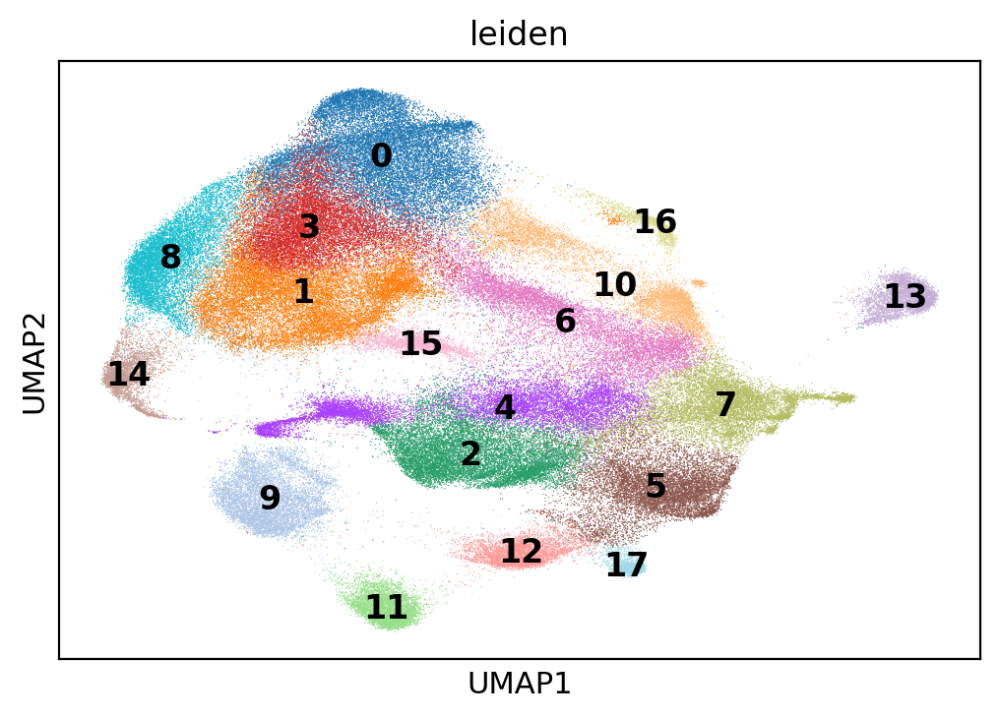

In [7]:
sc.pl.umap(ref,color='leiden',legend_loc = 'on data')

In [8]:
a1 = ref[ref.obs['leiden']=='2'].obs.index.tolist()

In [9]:
adata.obs['Defined_type']=adata.obs['Defined_type'].astype(str)

In [10]:
a2 = ref[ref.obs['leiden']=='4'].obs.index.tolist()

In [11]:
adata.obs.loc[adata.obs.index.isin(a1),'Defined_type']='FMC macrophage-1'
adata.obs.loc[adata.obs.index.isin(a2),'Defined_type']='FMC macrophage-2'

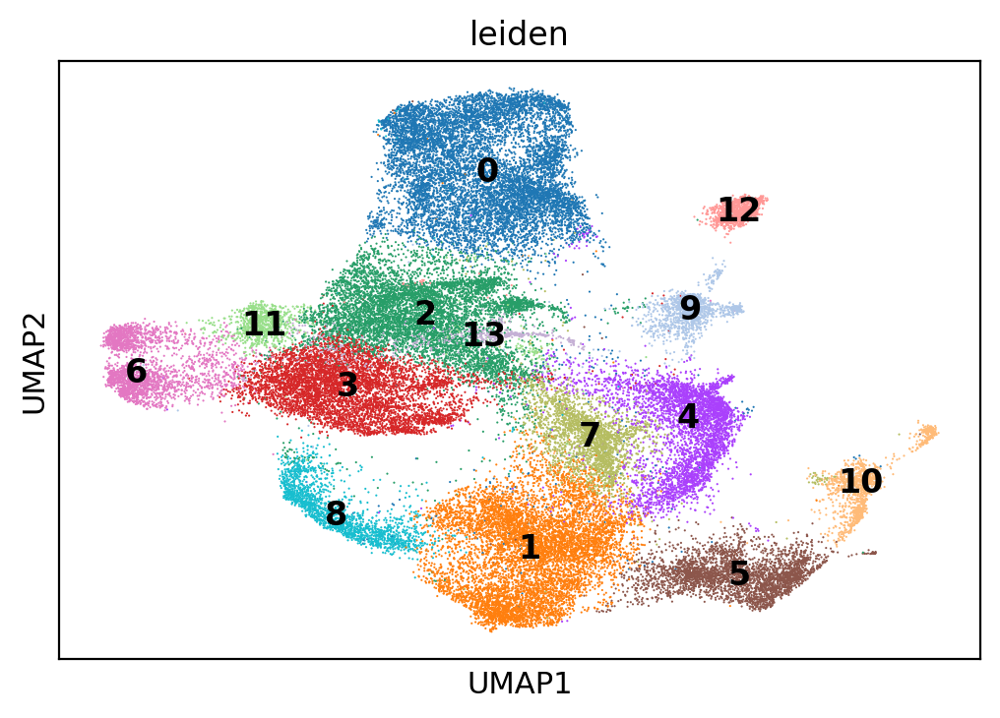

In [12]:
sc.pl.umap(adata,color='leiden',legend_loc = 'on data')

In [13]:
adata.obs['Defined_type'].value_counts()

FMC macrophage-1         12874
FMC macrophage-2         10027
Classical Monocyte        8508
Monocyte Macrophage       8432
FMC macrophage            6960
Nonclassical Monocyte     1831
Intermediate Monocyte     1293
Name: Defined_type, dtype: int64

In [14]:
#adata.write(out_path+'/human_subset_0707_cluster3_6.h5ad')

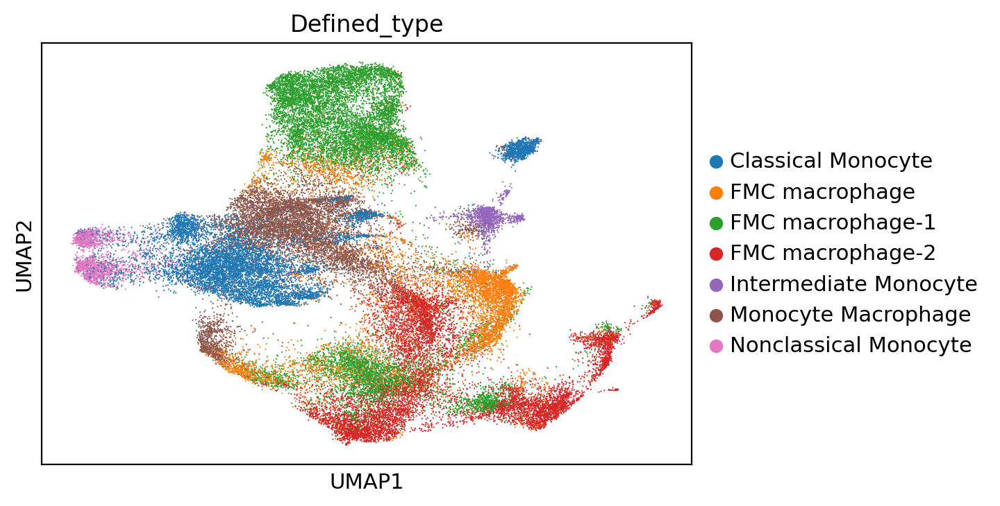

In [15]:
sc.pl.umap(adata,color='Defined_type')

In [16]:
adata

AnnData object with n_obs × n_vars = 49925 × 7567
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'Sample', 'batch', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'doublet_score', 'predicted_doublet', 'n_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'log_counts', 'leiden', 'Cell_Type', 'leiden_resol_3', 'Defined_type', 'Monocyte_factors', 'CD14_binary', 'FCGR3A_binary', 'CCR2_binary', 'CX3CR1_binary', 'Tcell_factors', 'CD8A_binary', 'CD3E_binary', 'velocity_self_transition'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', '

In [17]:
cr.tl.terminal_states(adata, cluster_key='Defined_type', weight_connectivities=0.2,n_jobs=4,n_states=6)


Accessing `adata.obsp['T_fwd']`


<ipython-input-17-aac1892afd84>:1: DeprecationWarning: `cellrank.tl.terminal_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.terminal_states(adata, cluster_key='Defined_type', weight_connectivities=0.2,n_jobs=4,n_states=6)
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(


Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


  0%|          | 0/49925 [00:00<?, ?cell/s]

Setting `softmax_scale=6.4963`


  0%|          | 0/49925 [00:00<?, ?cell/s]

    Finish (0:00:51)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Computing Schur decomposition
Mat Object: 1 MPI processes
  type: seqdense
1.0000000000000067e+00 -1.5494161172324555e-02 -1.3750598584632179e-01 -7.0268464739869793e-02 1.0247858070872859e-01 1.2482511415356744e-02 
0.0000000000000000e+00 8.9218694668986254e-01 -1.8214430975121553e-02 4.8300604865153625e-03 -3.3051444232944420e-02 -2.0097620354578950e-02 
0.0000000000000000e+00 0.0000000000000000e+00 8.1598919171942930e-01 2.6831641054478363e-02 -4.5837998883760445e-02 -1.0030028313807569e-01 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 7.9052914780887329e-01 2.4440688887532688e-02 3.5073684143097410e-02 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e+00 -5.6818643922258855e-03 7.9052914780887329e-01 3.1000922874667949e-02 
0.0000000000000000e+00 0.0000000000000000e+00 0.0000000000000000e

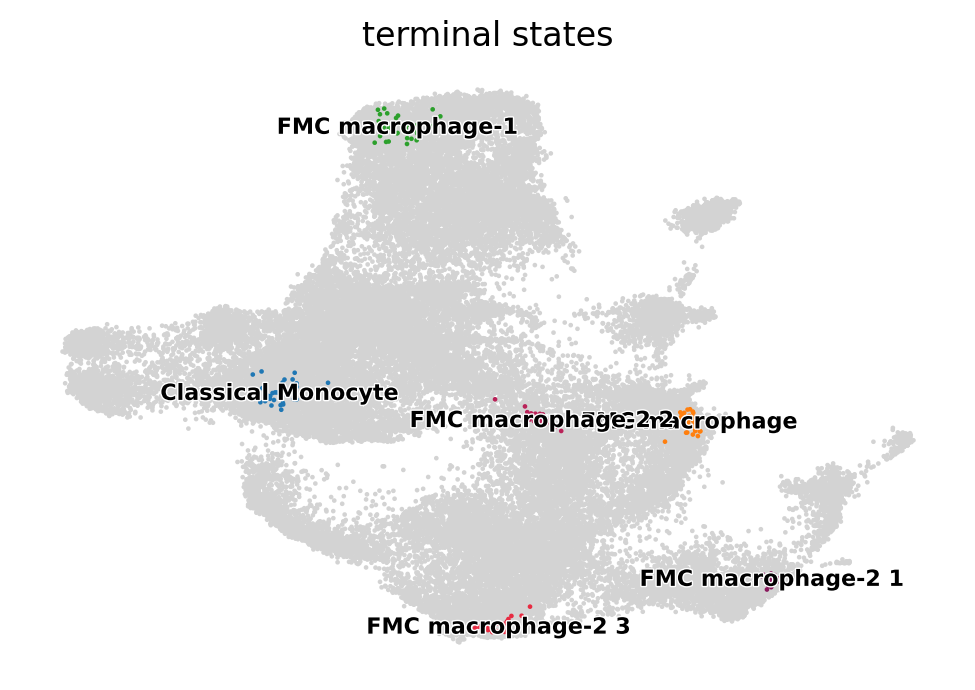

In [18]:
cr.pl.terminal_states(adata, discrete=True,legend_fontsize=8)

Accessing `adata.obsp['T_bwd']`


/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-19-541791c2268e>:1: DeprecationWarning: `cellrank.tl.initial_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.initial_states(adata, cluster_key='Defined_type',n_jobs=4,n_states=1)
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(


Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


  0%|          | 0/49925 [00:00<?, ?cell/s]

Setting `softmax_scale=6.4963`


  0%|          | 0/49925 [00:00<?, ?cell/s]

    Finish (0:01:00)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Computing eigendecomposition of the transition matrix
Adding `adata.uns['eigendecomposition_bwd']`
       `.eigendecomposition`
    Finish (0:00:15)
For 1 macrostate, stationary distribution is computed
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['initial_states']`
       `adata.obs['initial_states_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


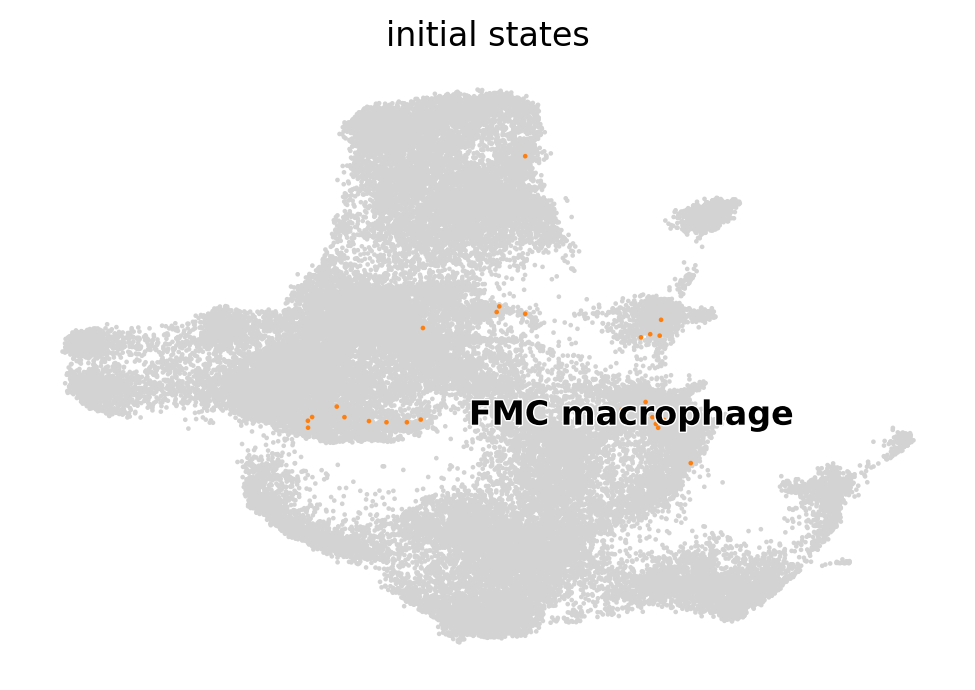

In [19]:
cr.tl.initial_states(adata, cluster_key='Defined_type',n_jobs=4,n_states=1)
cr.pl.initial_states(adata, discrete=True)

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-20-4ec1421c6596>:1: DeprecationWarning: `cellrank.tl.lineages` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineages(adata)


Computing absorption probabilities


  0%|          | 0/6 [00:00<?, ?/s]

Adding `adata.obsm['to_terminal_states']`
       `.absorption_probabilities`
    Finish (0:00:07)


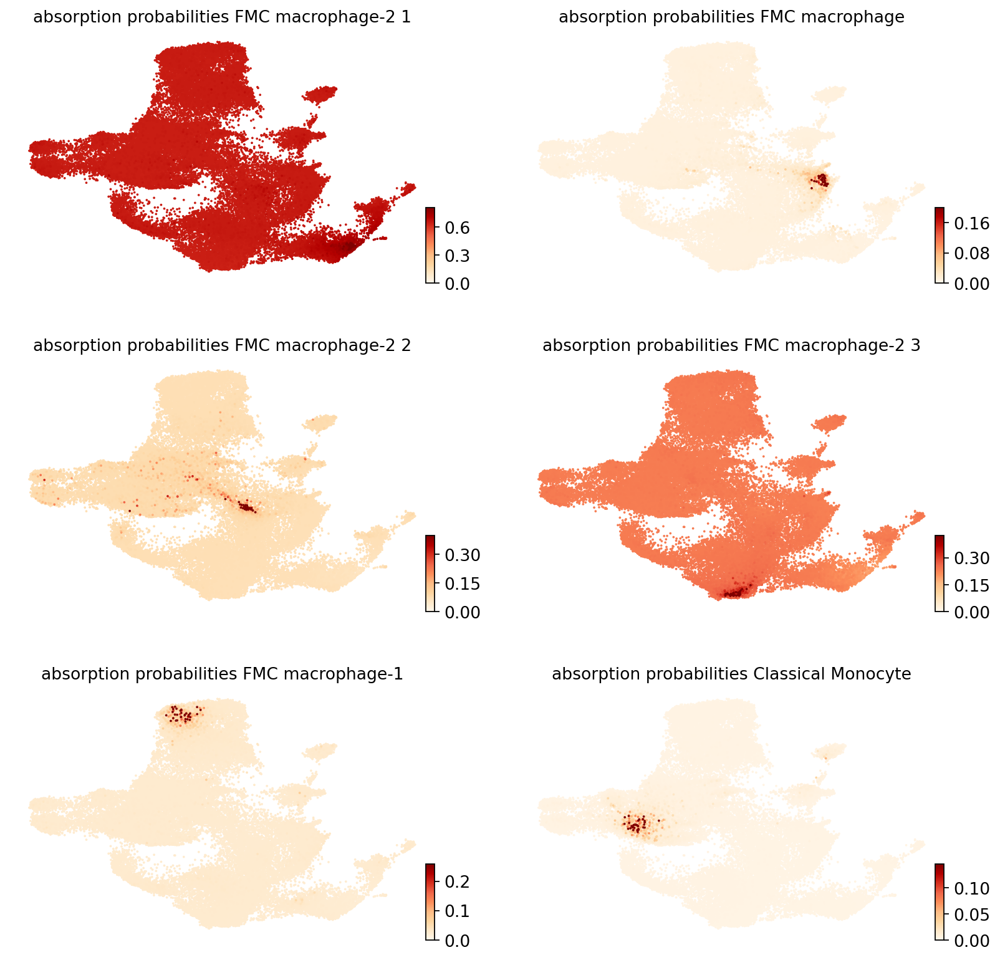

In [20]:
cr.tl.lineages(adata)
cr.pl.lineages(adata, same_plot=False,ncols=2,cmap='OrRd')

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


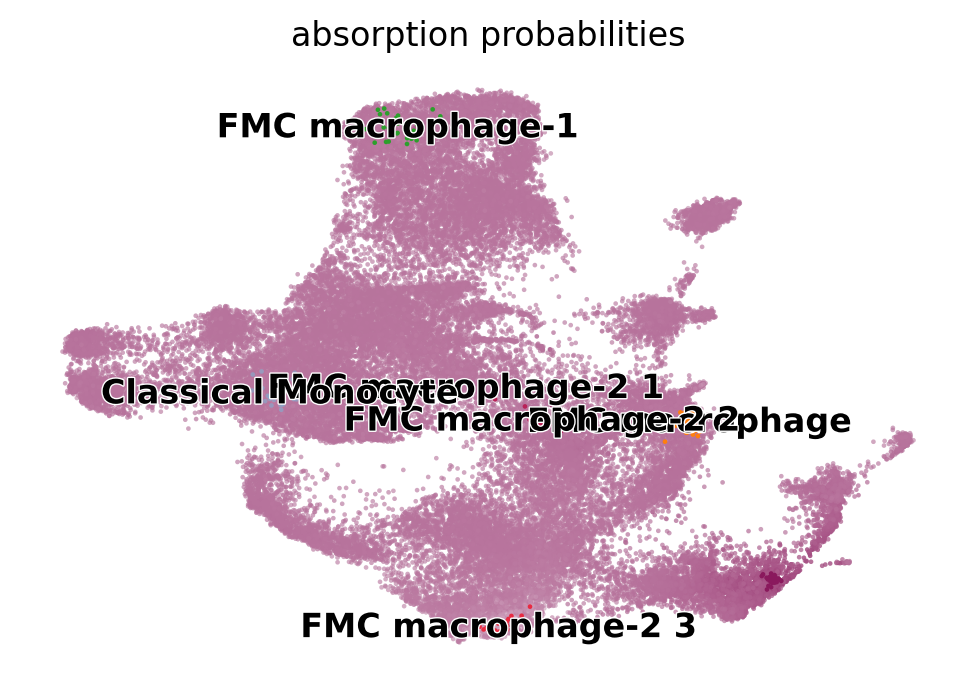

In [21]:
cr.pl.lineages(adata, discrete=True)

In [22]:
adata

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


AnnData object with n_obs × n_vars = 49925 × 7567
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'Sample', 'batch', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'doublet_score', 'predicted_doublet', 'n_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'log_counts', 'leiden', 'Cell_Type', 'leiden_resol_3', 'Defined_type', 'Monocyte_factors', 'CD14_binary', 'FCGR3A_binary', 'CCR2_binary', 'CX3CR1_binary', 'Tcell_factors', 'CD8A_binary', 'CD3E_binary', 'velocity_self_transition', 'terminal_states', 'terminal_states_probs', 'initial_states', 'initial_states_probs', 'clusters_gradients'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts

In [23]:
scv.tl.velocity_pseudotime(
    adata, root_key="initial_states_probs", end_key="terminal_states_probs"
)

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


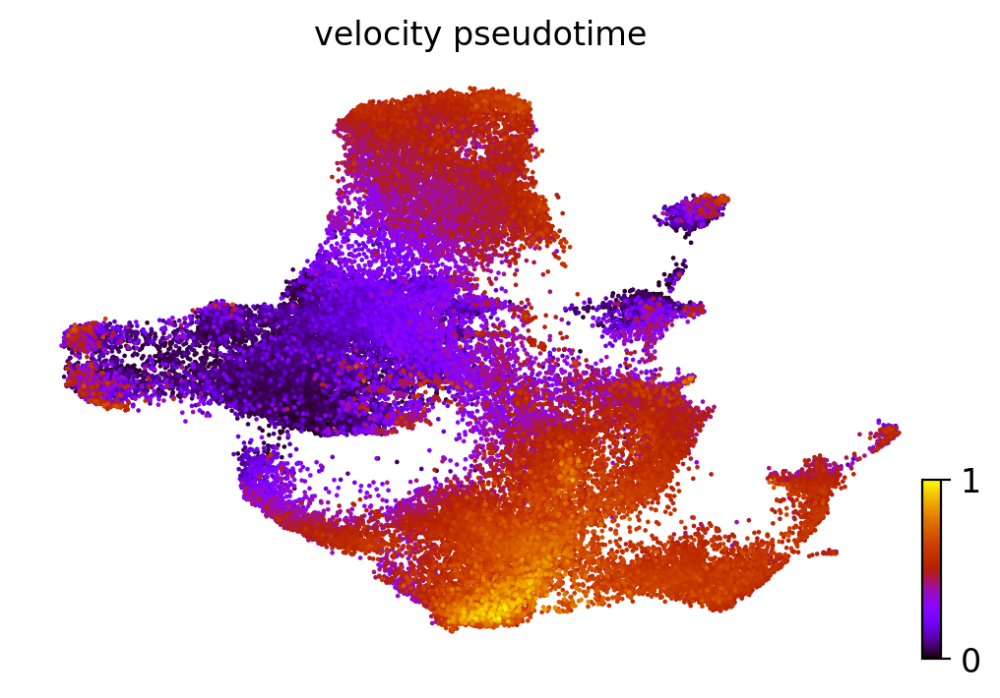

In [24]:
scv.pl.scatter(adata, color='velocity_pseudotime', color_map='gnuplot')

In [25]:
#scv.tl.recover_latent_time( adata, root_key="initial_states_probs", end_key="terminal_states_probs")

In [26]:
scv.tl.paga(
    adata,
    groups="Defined_type",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior='velocity_pseudotime',
)

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:01:13) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/networkx/drawing/nx_pylab.py:717: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  edge_collection = mpl.collections.LineCollection(


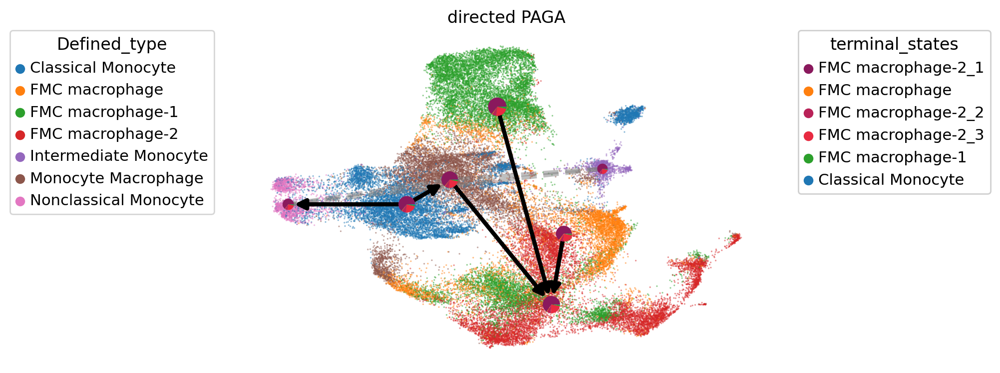

In [27]:
cr.pl.cluster_fates(
    adata,
    mode="paga_pie",
    cluster_key="Defined_type",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="top left out",
    node_size_scale=1,
    edge_width_scale=1,
    max_edge_width=3,
    title="directed PAGA",
)

In [28]:
scv.tl.paga(
    adata,
    groups="leiden",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="velocity_pseudotime",
)

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:01:16) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/networkx/drawing/nx_pylab.py:717: MatplotlibDeprecationWarning: Passing *transOffset* without *offsets* has no effect. This behavior is deprecated since 3.5 and in 3.6, *transOffset* will begin having an effect regardless of *offsets*. In the meantime, if you wish to set *transOffset*, call collection.set_offset_transform(transOffset) explicitly.
  edge_collection = mpl.collections.LineCollection(


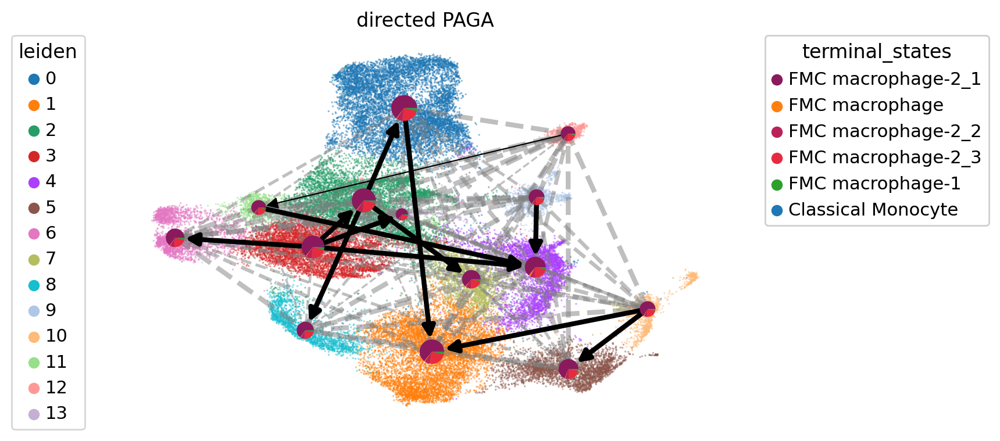

In [29]:
cr.pl.cluster_fates(
    adata,
    mode="paga_pie",
    cluster_key="leiden",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="top left out",
    node_size_scale=1,
    edge_width_scale=1,
    max_edge_width=3,
    title="directed PAGA",
)

In [30]:
cr.tl.lineage_drivers(adata)

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-30-b827be8b05bf>:1: DeprecationWarning: `cellrank.tl.lineage_drivers` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineage_drivers(adata)


Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:07)


,FMC macrophage-2_1_corr,FMC macrophage-2_1_pval,FMC macrophage-2_1_qval,FMC macrophage-2_1_ci_low,FMC macrophage-2_1_ci_high,FMC macrophage_corr,FMC macrophage_pval,FMC macrophage_qval,FMC macrophage_ci_low,FMC macrophage_ci_high,...,FMC macrophage-1_corr,FMC macrophage-1_pval,FMC macrophage-1_qval,FMC macrophage-1_ci_low,FMC macrophage-1_ci_high,Classical Monocyte_corr,Classical Monocyte_pval,Classical Monocyte_qval,Classical Monocyte_ci_low,Classical Monocyte_ci_high
CHI3L1,0.296057,0.000000e+00,NaN,0.288033,0.304039,-0.025892,7.191457e-09,NaN,-0.034656,-0.017124,...,-0.043666,1.628089e-22,NaN,-0.052418,-0.034908,-0.020452,4.871039e-06,NaN,-0.029219,-0.011682
CHIT1,0.261833,0.000000e+00,NaN,0.253644,0.269985,-0.025931,6.823930e-09,NaN,-0.034695,-0.017163,...,-0.023456,1.589696e-07,NaN,-0.032222,-0.014687,-0.021124,2.352170e-06,NaN,-0.029891,-0.012355
SPARC,0.137017,2.064483e-208,NaN,0.128399,0.145614,-0.010996,1.400896e-02,NaN,-0.019766,-0.002225,...,-0.002880,5.198378e-01,NaN,-0.011652,0.005892,-0.017219,1.192359e-04,NaN,-0.025987,-0.008449
LIPA,0.132737,1.420632e-195,NaN,0.124110,0.141345,-0.027165,1.270062e-09,NaN,-0.035929,-0.018398,...,0.018540,3.428772e-05,NaN,0.009770,0.027308,-0.045324,3.913911e-24,NaN,-0.054074,-0.036566
DNASE2B,0.123794,4.078025e-170,NaN,0.115147,0.132422,-0.005394,2.281305e-01,NaN,-0.014165,0.003378,...,-0.017167,1.250309e-04,NaN,-0.025935,-0.008396,-0.012168,6.552706e-03,NaN,-0.020937,-0.003396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC079328.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
FLNB-AS1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AC012100.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AC009087.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [31]:
Terminals = adata.obs['terminal_states'].unique().tolist()

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [32]:
Terminals.remove(np.NaN)

In [33]:
adata.varm['terminal_lineage_drivers']

,FMC macrophage-2_1_corr,FMC macrophage-2_1_pval,FMC macrophage-2_1_qval,FMC macrophage-2_1_ci_low,FMC macrophage-2_1_ci_high,FMC macrophage_corr,FMC macrophage_pval,FMC macrophage_qval,FMC macrophage_ci_low,FMC macrophage_ci_high,...,FMC macrophage-1_corr,FMC macrophage-1_pval,FMC macrophage-1_qval,FMC macrophage-1_ci_low,FMC macrophage-1_ci_high,Classical Monocyte_corr,Classical Monocyte_pval,Classical Monocyte_qval,Classical Monocyte_ci_low,Classical Monocyte_ci_high
ZNHIT1,0.001192,0.790015,NaN,-0.007580,0.009964,-0.028263,2.674611e-10,NaN,-0.037026,-0.019496,...,-0.001137,0.799509,NaN,-0.009908,0.007635,0.001944,0.664100,NaN,-0.006828,0.010715
LATS1,0.012633,0.004761,NaN,0.003862,0.021403,-0.006334,1.570041e-01,NaN,-0.015105,0.002438,...,-0.004225,0.345131,NaN,-0.012997,0.004547,-0.002883,0.519541,NaN,-0.011654,0.005889
ADAT1,0.001430,0.749423,NaN,-0.007342,0.010201,-0.006347,1.561626e-01,NaN,-0.015118,0.002425,...,-0.002568,0.566091,NaN,-0.011340,0.006204,0.001596,0.721402,NaN,-0.007176,0.010368
MARCH6,0.006267,0.161448,NaN,-0.002505,0.015038,-0.013022,3.617524e-03,NaN,-0.021791,-0.004251,...,0.001654,0.711685,NaN,-0.007118,0.010426,-0.001625,0.716468,NaN,-0.010397,0.007146
SPATA13,0.011067,0.013405,NaN,0.002295,0.019837,0.005951,1.835950e-01,NaN,-0.002821,0.014723,...,-0.008957,0.045360,NaN,-0.017727,-0.000185,-0.002816,0.529246,NaN,-0.011587,0.005956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF561-AS1,0.004051,0.365343,NaN,-0.004721,0.012823,0.006837,1.266059e-01,NaN,-0.001935,0.015608,...,-0.001077,0.809752,NaN,-0.009849,0.007694,-0.006984,0.118648,NaN,-0.015755,0.001788
TOR3A,0.015203,0.000681,NaN,0.006432,0.023972,-0.013999,1.759841e-03,NaN,-0.022768,-0.005228,...,-0.001743,0.696957,NaN,-0.010515,0.007029,0.000671,0.880788,NaN,-0.008101,0.009443
JOSD1,-0.010220,0.022404,NaN,-0.018990,-0.001448,-0.006719,1.333073e-01,NaN,-0.015490,0.002053,...,-0.001926,0.666945,NaN,-0.010698,0.006846,0.005942,0.184321,NaN,-0.002830,0.014713
F11R,0.015921,0.000374,NaN,0.007150,0.024689,-0.014870,8.915434e-04,NaN,-0.023639,-0.006099,...,0.010032,0.024994,NaN,0.001260,0.018802,-0.010515,0.018805,NaN,-0.019285,-0.001743


In [34]:
adata

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


AnnData object with n_obs × n_vars = 49925 × 7567
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'Sample', 'batch', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'doublet_score', 'predicted_doublet', 'n_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'log_counts', 'leiden', 'Cell_Type', 'leiden_resol_3', 'Defined_type', 'Monocyte_factors', 'CD14_binary', 'FCGR3A_binary', 'CCR2_binary', 'CX3CR1_binary', 'Tcell_factors', 'CD8A_binary', 'CD3E_binary', 'velocity_self_transition', 'terminal_states', 'terminal_states_probs', 'initial_states', 'initial_states_probs', 'clusters_gradients', 'velocity_pseudotime'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by

In [35]:
#adata.write(out_path+'/human_subset_0607.h5ad')

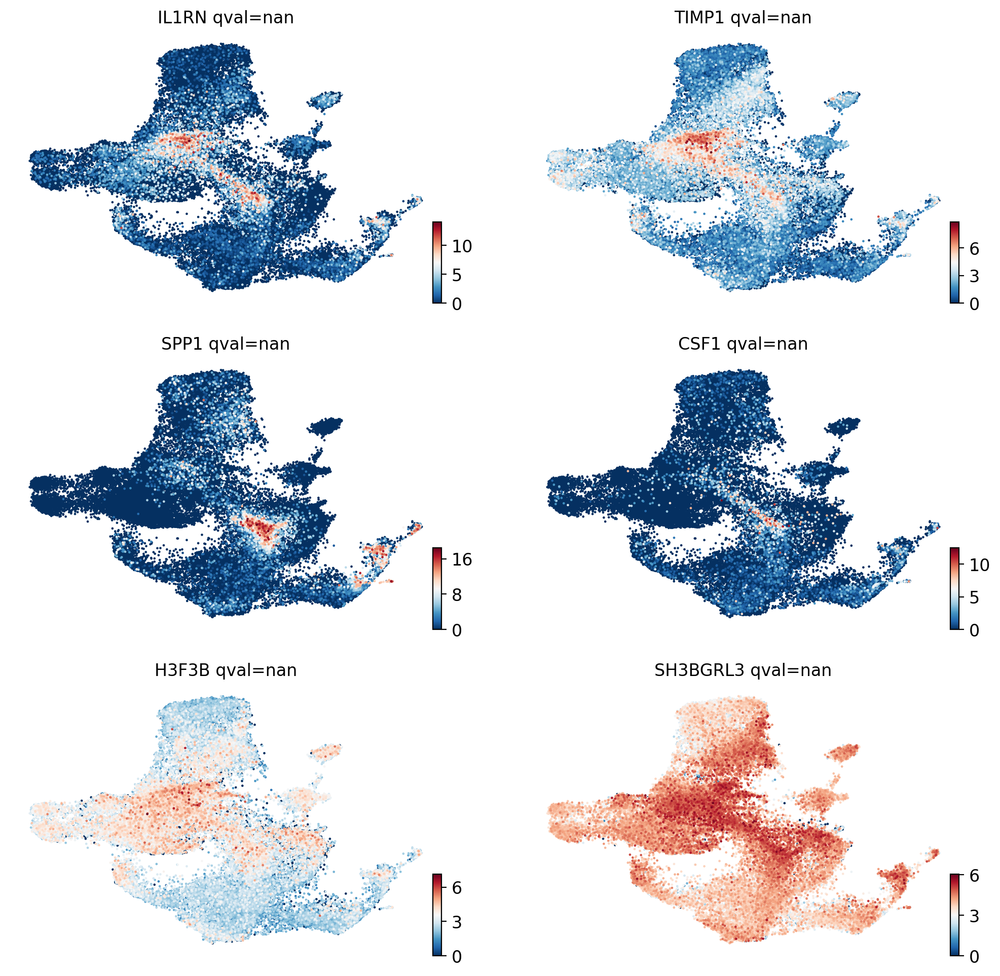

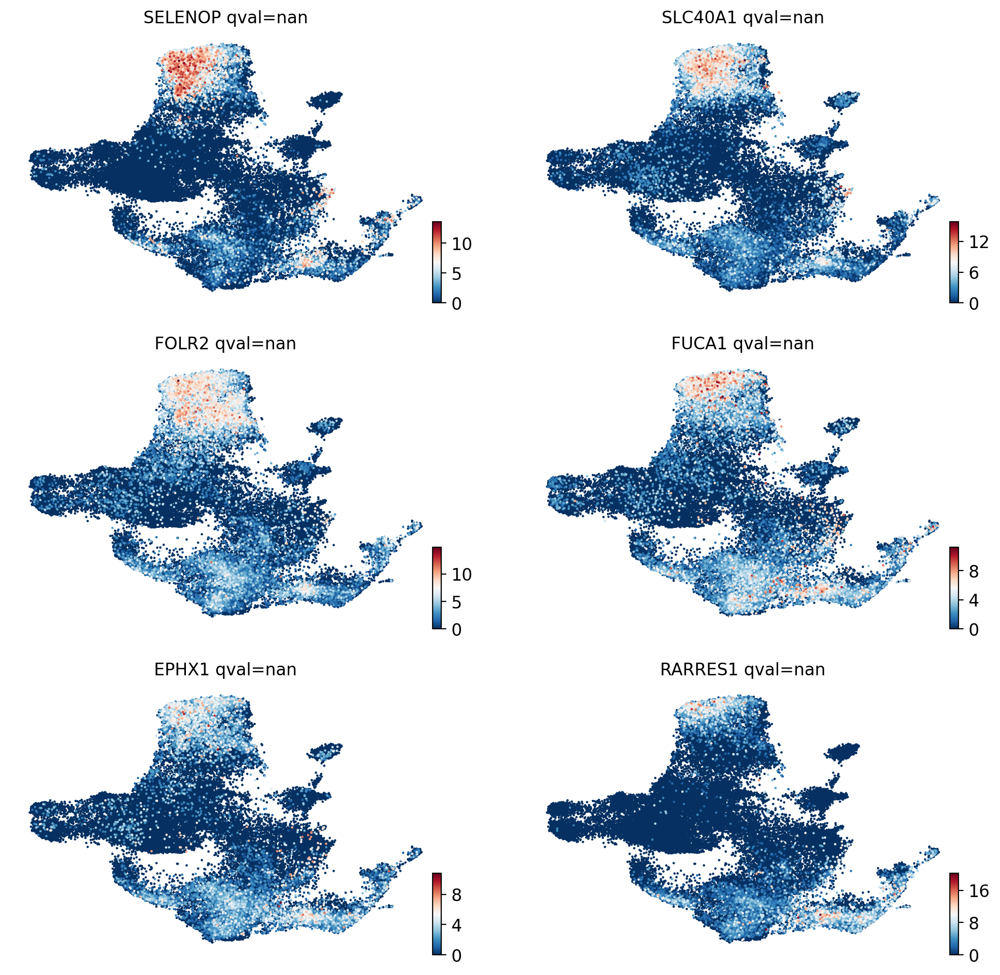

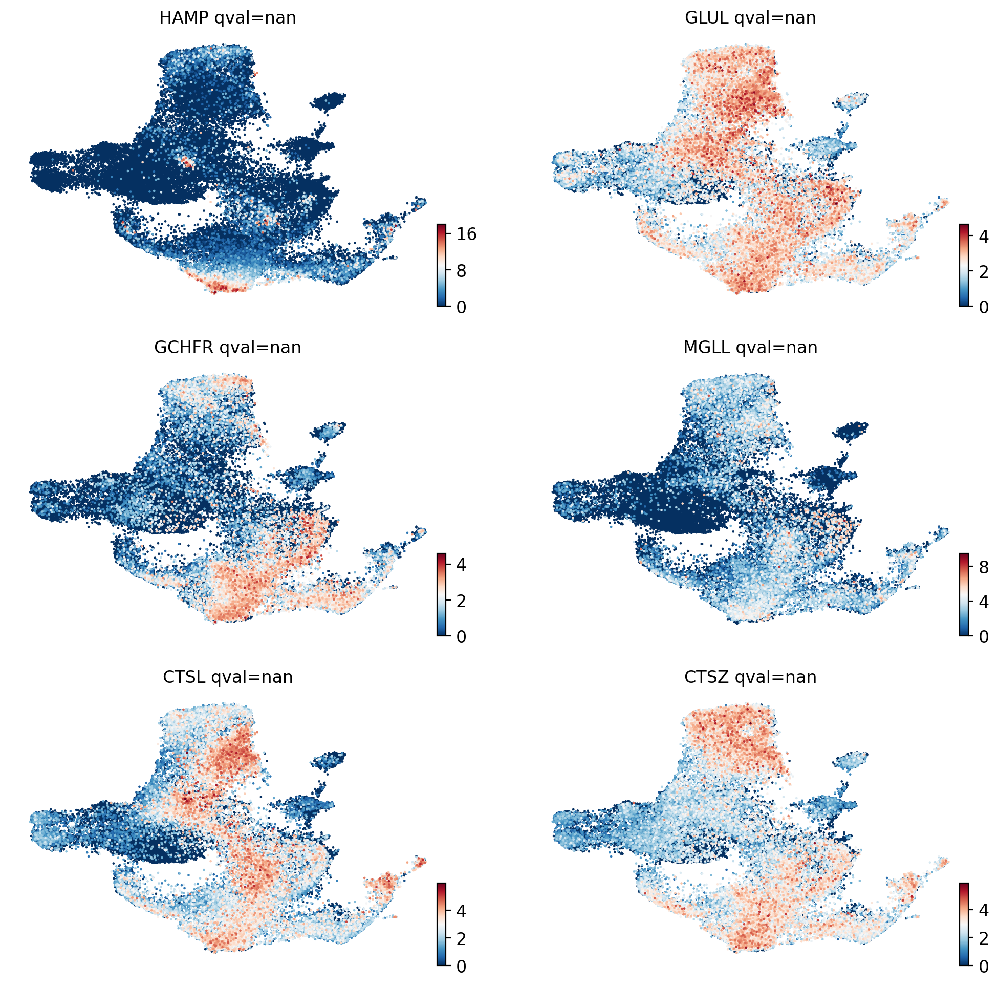

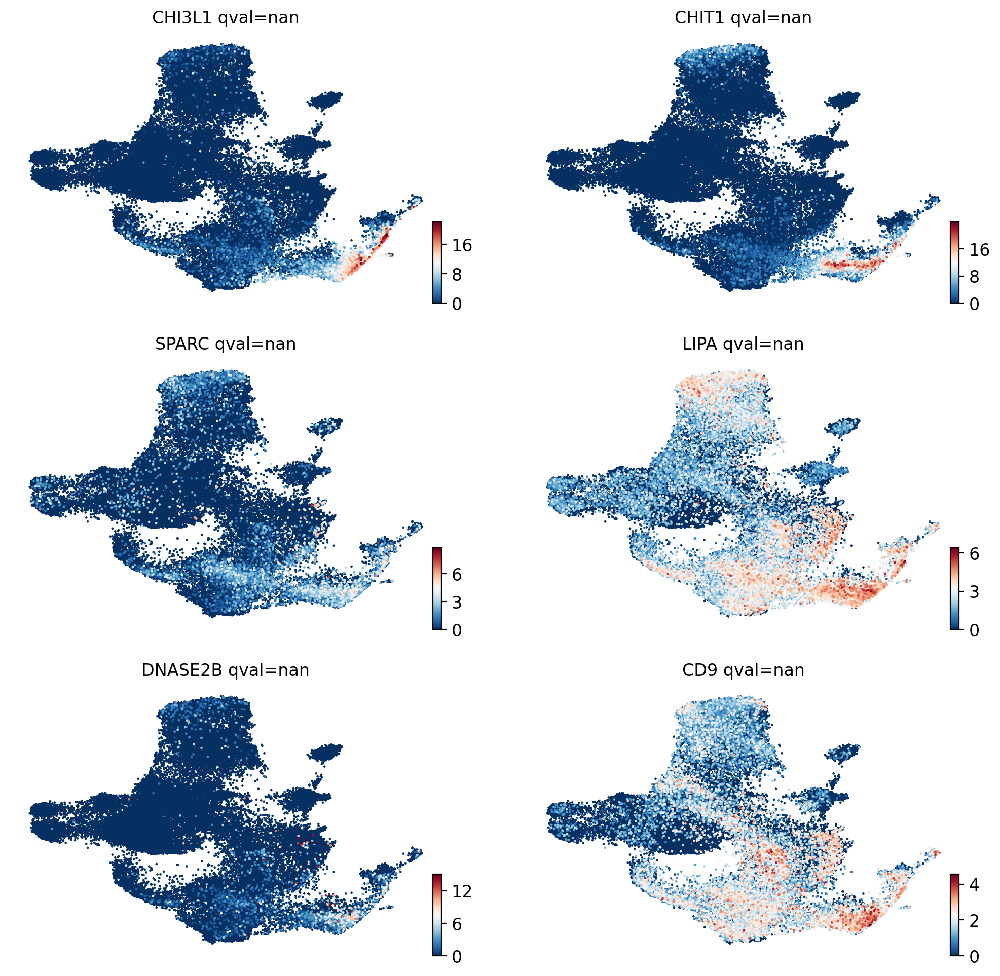

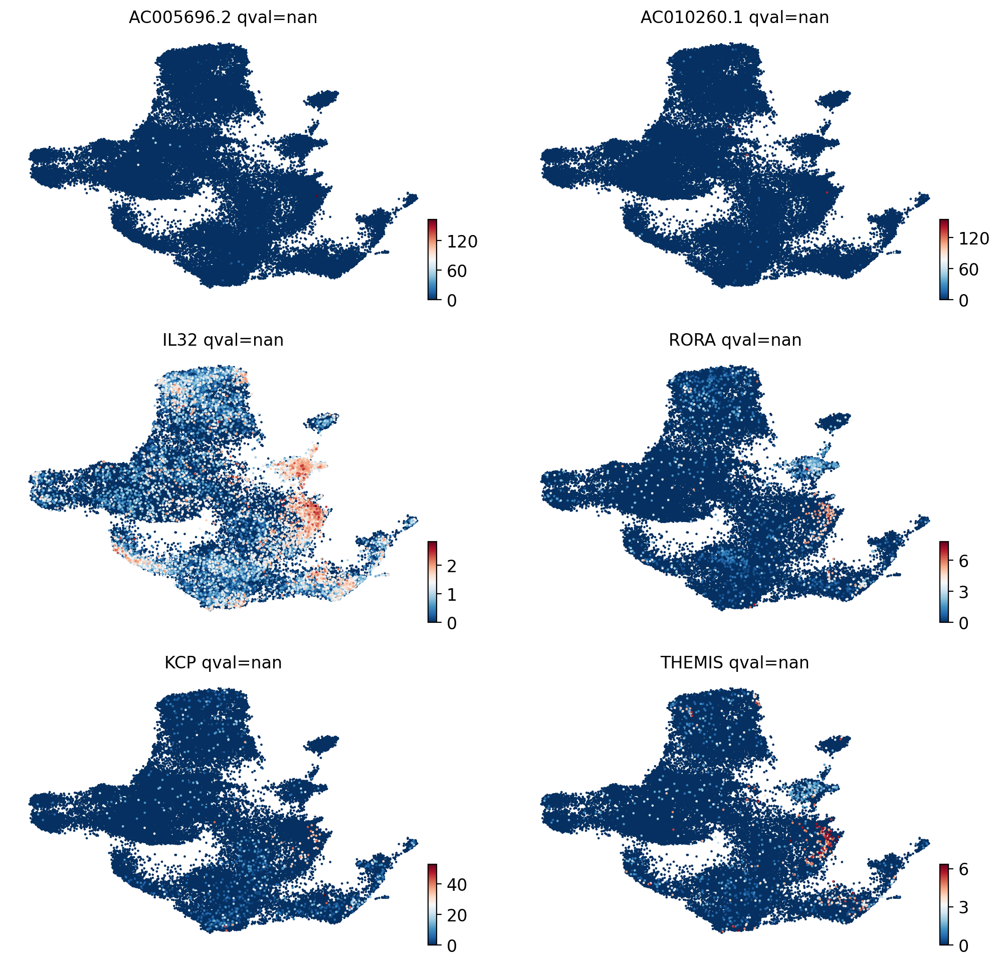

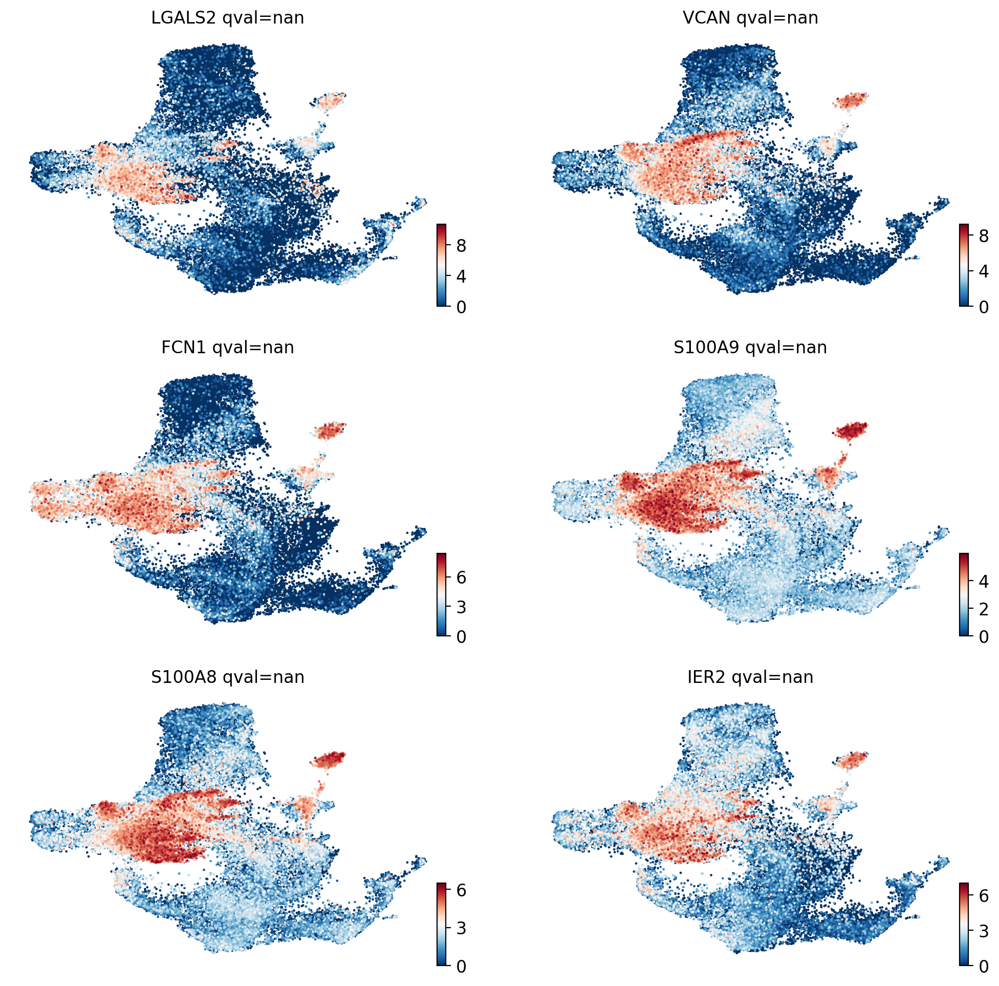

In [36]:
for te in Terminals:
    cr.pl.lineage_drivers(adata, lineage=te, n_genes=6,ncols=2)

In [37]:
Terminals = adata.obs['terminal_states'].unique().tolist()
Terminals.remove(np.nan)
top_drivers = {}
for te in Terminals:
    top_drivers[te]=adata.varm['terminal_lineage_drivers'][te+"_corr"].sort_values(ascending=False).index[:200]
top_200 = pd.DataFrame(top_drivers)
top_200.to_csv(out_path+'/human_subset_0707_cluster3_6_drivers.csv')

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [38]:
Terminals = adata.obs['terminal_states'].unique().tolist()
Terminals.remove(np.nan)
top3_drivers = []
for te in Terminals:
    top3_drivers.extend(adata.varm['terminal_lineage_drivers'][te+"_corr"].sort_values(ascending=False).index[:1])


In [39]:
top3_drivers

['IL1RN', 'SELENOP', 'HAMP', 'CHI3L1', 'AC005696.2', 'LGALS2']

Computing trends using `1` core(s)


  0%|          | 0/6 [00:00<?, ?gene/s]

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review y

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review y

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review y

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review y

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review y

/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review y

    Finish (0:00:30)
Plotting trends


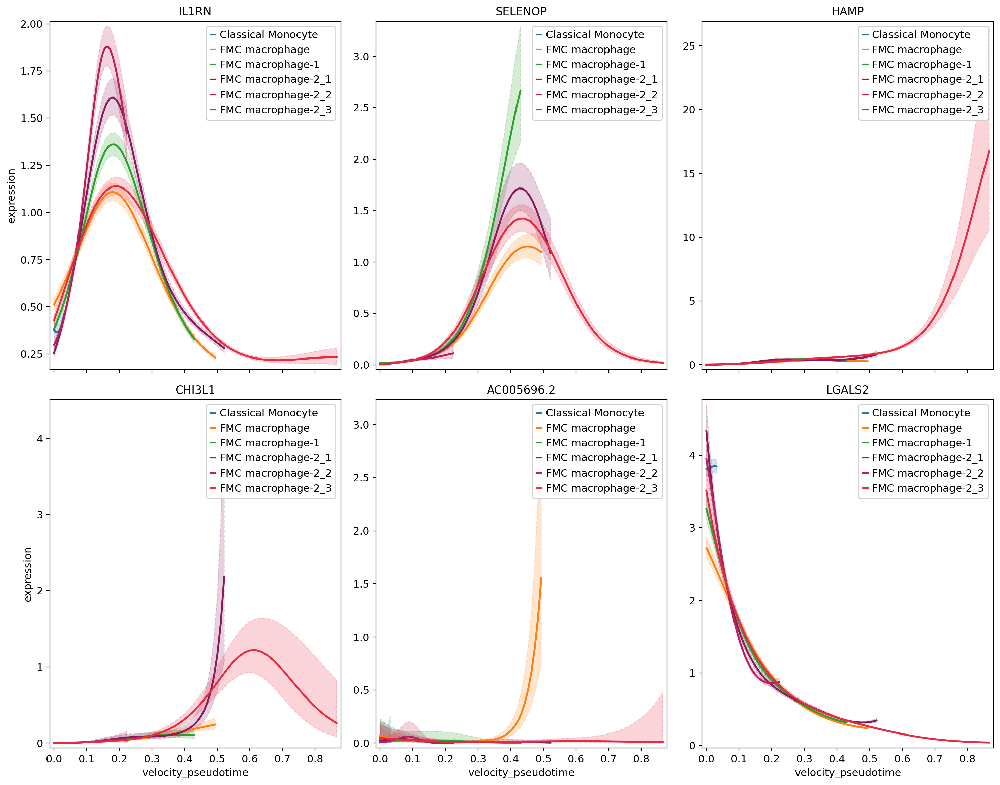

In [40]:
model = cr.ul.models.GAM(adata)
cr.pl.gene_trends(
    adata,
    model=model,
    data_key="X",
    genes=top3_drivers,
    ncols=3,
    time_key="velocity_pseudotime",
    same_plot=True,
    hide_cells=True,
    figsize=(15, 12),
    n_test_points=50,
)

In [41]:

from pyBCS import scanpy2bcs
scanpy2bcs.format_data(out_path+'/human_subset_0707_cluster3_6.h5ad', out_path+'/human_subset_0707_cluster3_6.bcs',
                        input_format="h5ad", graph_based="leiden")


/user/ifrec/liuyuchen/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Writing main/metadata/metalist.json
Cannot convert Sample to numeric, treating as categorical
Cannot convert predicted_doublet to numeric, treating as categorical
Cannot convert leiden to numeric, treating as categorical
Cannot convert Cell_Type to numeric, treating as categorical
Cannot convert Defined_type to numeric, treating as categorical
Cannot convert Monocyte_factors to numeric, treating as categorical
Cannot convert CD14_binary to numeric, treating as categorical
Cannot convert FCGR3A_binary to numeric, treating as categorical
Cannot convert CCR2_binary to numeric, treating as categorical
Cannot convert CX3CR1_binary to numeric, treating as categorical
Cannot convert Tcell_factors to numeric, treating as categorical
Cannot convert CD8A_binary to numeric, treating as categorical
Cannot convert CD3E_binary to numeric, treating as categorical
Found graph based clustering in metadata with keyword leiden
Writing main/metadata/efbbdb7f70d047d3b9084b8b9e65ae5c.json
Writing main/metad

'/user/ifrec/liuyuchen/Analysis_Reports/Akira_Fukusima_scRNASeq/human//human_subset_0707_cluster3_6.bcs'